#### Q Explain the Basic Life Cycle of a Data Science Project?
The basic life cycle of a data science project typically involves the following stages:<br>
<b>Problem Formulation</b>: The first step in a data science project is to clearly define the problem or question that you are trying to answer. This involves understanding the business context, identifying the relevant data sources, and defining the project scope.<br>
<b>Data Collection</b>: In this stage, data is gathered from various sources, such as internal databases, external APIs, and public datasets. The quality and quantity of the data collected will directly impact the success of the project, so it is important to ensure that the data is clean, complete, and relevant to the problem at hand.<br>
<b>Data Preparation</b>: After data collection, the data needs to be cleaned, transformed, and formatted to make it usable for analysis. This involves tasks such as handling missing values, dealing with outliers, and normalizing the data.<br>
<b>Data Exploration</b>: In this stage, exploratory data analysis is conducted to gain insights into the data and identify patterns or relationships that may be relevant to the problem. This can involve visualizing the data, running descriptive statistics, and performing feature selection.<br>
<b>Modeling</b>: In this stage, statistical or machine learning models are developed to predict or classify the data based on the problem statement. The choice of model will depend on the type of data and the nature of the problem.<br>
<b>Evaluation</b>: After developing the model, it needs to be evaluated to determine its accuracy and effectiveness. This involves testing the model on a validation set or using cross-validation techniques to ensure that the model generalizes well.<br>
<b>Deployment</b>: Once the model is deemed to be accurate and effective, it can be deployed to production. This involves integrating the model into the existing system or creating a new system to serve the predictions.<br>
<b>Monitoring and Maintenance</b>: After deployment, it is important to monitor the performance of the model and ensure that it continues to produce accurate results over time. This involves periodic maintenance and updates to the model as new data becomes available or changes occur in the business context.<br>


 #### Why do you want to join Apollo Energy Analytics?

As an experienced software engineer, I am looking for a company where I can apply my analytics and machine learning expertise to solve challenges in the energy industry. 
I am impressed with this company's commitment to advancing sustainability, and I believe that analytics and machine learning can play a crucial role in achieving these goals. 
The chance to work with a team of talented professionals who are passionate about making a positive impact in the world is extremely appealing to me.




#### Q3. Please provide a detailed analysis of the data set available in this directory.

### Importing Library and Dataset

In [3]:
import pandas as pd
import numpy as np

from datetime import datetime

#plotly library
import plotly
plotly.offline.init_notebook_mode (connected = True)
import plotly.express as px
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly import subplots
import plotly.io as pio

In [4]:
data = pd.read_csv("df_covid19_countries.csv")

In [5]:
data.head()

,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,reproduction_rate,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,population,vaccination_ratio,prevalence,incidence
0,Afghanistan,2020-02-24,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41128772.0,0.0,0.000012,0.000012
1,Afghanistan,2020-02-25,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41128772.0,0.0,0.000012,0.000000
2,Afghanistan,2020-02-26,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41128772.0,0.0,0.000012,0.000000
3,Afghanistan,2020-02-27,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41128772.0,0.0,0.000012,0.000000
4,Afghanistan,2020-02-28,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41128772.0,0.0,0.000012,0.000000


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 234802 entries, 0 to 234801
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   location                 234802 non-null  object 
 1   date                     234802 non-null  object 
 2   total_cases              234802 non-null  float64
 3   new_cases                234802 non-null  float64
 4   new_cases_smoothed       234802 non-null  float64
 5   total_deaths             234802 non-null  float64
 6   new_deaths               234802 non-null  float64
 7   new_deaths_smoothed      234802 non-null  float64
 8   reproduction_rate        234802 non-null  float64
 9   total_vaccinations       234802 non-null  float64
 10  people_vaccinated        234802 non-null  float64
 11  people_fully_vaccinated  234802 non-null  float64
 12  total_boosters           234802 non-null  float64
 13  population               234802 non-null  float64
 14  vacc

### Data Transformation

In [7]:
data['year']=pd.to_datetime(data['date']).dt.strftime('%Y')
data['year-month']=pd.to_datetime(data['date']).dt.strftime('%Y-%b')
data['month']=pd.to_datetime(data['date']).dt.strftime('%b')
data['day']=pd.to_datetime(data['date']).dt.strftime('%d')

In [8]:
data['location'].value_counts()

Mexico            1100
Argentina         1100
Thailand          1097
Taiwan            1085
South Korea       1079
                  ... 
Tokelau            533
Palau              501
Niue               485
Pitcairn           441
Western Sahara       1
Name: location, Length: 236, dtype: int64

In [54]:
def get_total_sum_country(df):
    '''
    This will give a dictionary which contains the total varialble sum over the period.
    '''
    iso_pop={}
    for loc in df['location'].unique():
        temp = df[df['location']==loc].copy()
        temp = temp.reset_index()
        c = temp.loc[0,'population']
        iso_pop[loc]={}#data[data['location']==loc].iloc[-1]['population']
        iso_pop[loc]['total_cases']=temp['total_cases'].max()
        iso_pop[loc]['total_deaths']=temp['total_deaths'].max()
        iso_pop[loc]['max_cases_in_a_day']=temp['new_cases'].max()
        iso_pop[loc]['max_deaths_in_a_day']=temp['new_deaths'].max()
        iso_pop[loc]['population']=temp.loc[0,'population']
        sum_iso_df=pd.DataFrame(iso_pop)
        sum_iso_df=sum_iso_df.T
    return sum_iso_df

In [55]:
df_country_map=get_total_sum_country(data)
df_country_map['death-to-case-ratio'] = df_country_map['total_deaths']/df_country_map['total_cases']
df_country_map['death-to-population-ratio'] = df_country_map['total_deaths']/df_country_map['population']
df_country_map['case-to-population-ratio'] = df_country_map['total_cases']/df_country_map['population']
df_country_map.head()

,total_cases,total_deaths,max_cases_in_a_day,max_deaths_in_a_day,population,death-to-case-ratio,death-to-population-ratio,case-to-population-ratio
Afghanistan,207715.0,7850.0,3243.0,159.0,41128772.0,0.037792,0.000191,0.005050
Albania,333818.0,3596.0,4789.0,21.0,2842318.0,0.010772,0.001265,0.117446
Algeria,271236.0,6881.0,2521.0,49.0,44903228.0,0.025369,0.000153,0.006040
Andorra,47751.0,165.0,2313.0,7.0,79843.0,0.003455,0.002067,0.598061
Angola,105095.0,1930.0,5035.0,30.0,35588996.0,0.018364,0.000054,0.002953


### Data Exploration

In [56]:
def top_10_countries_report(df_plot,col):
    '''
    This function generate the top 10 countries analysis about the Covid
    '''
    world_cases=pd.DataFrame(df_plot.loc[:,col])
    world_cases['location']=world_cases.index
    hz_bar=world_cases.sort_values(by=col,ascending=False,axis=0)[:10]
    fig = go.Figure()
    fig.add_trace(go.Bar(y=hz_bar['location'],
                         x=hz_bar[col],
                         orientation='h', text=hz_bar[col],
                         textposition='inside',
                         marker={'color':'pink'},
                         textfont=dict(
                             family="sans serif",
                             size=16,
                             color="#efe4dc"),
                         showlegend=True,
                         name=col
                         ))
    fig.update_yaxes(
        title_font=dict(size=10), automargin=True
    )
    fig.update_xaxes(visible=False)
    fig.update_layout(plot_bgcolor="white", title=dict(
        text='<b>' + f'{"Top 10 Countries Report: "+col}' + '</b>',
        x=0.5,
        y=0.95,
        font=dict(
            family='moonspace',
            size=24,
            color='black'
        )))
    fig.update_layout(height=700,yaxis=dict(autorange="reversed"))
    #design the main format
    main_annot_format = "<span style='font-size:12px; font-family:Tahoma;'><b> %s </b><br> %s</span>"

    fig.add_annotation(dict(
            x=0.65,
            y=0.75,
            xref = "paper",
            yref = "paper",
            text= main_annot_format % (str(col),"Top 10 countries data"),
            ax=0, ay=0
    ))
    fig.show()


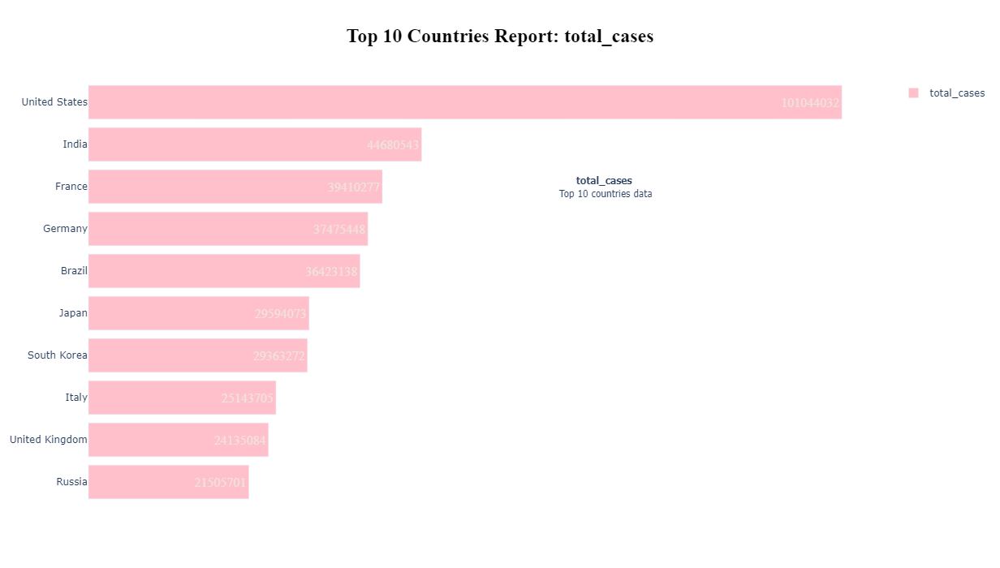

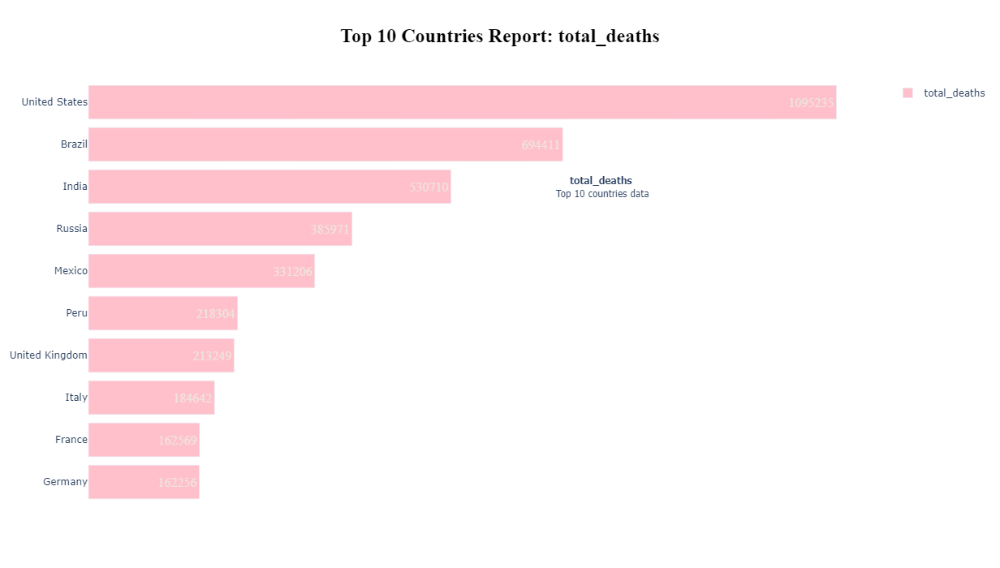

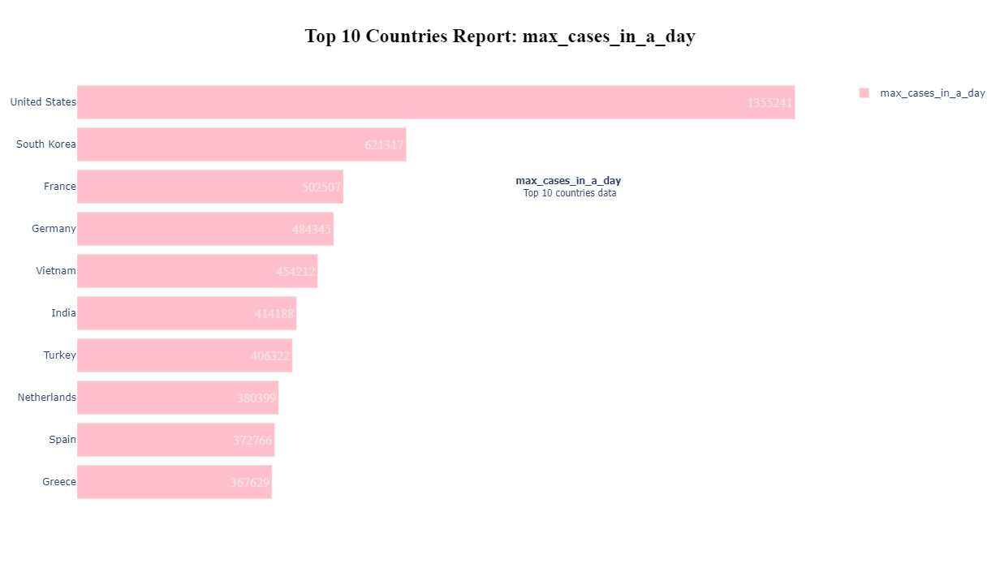

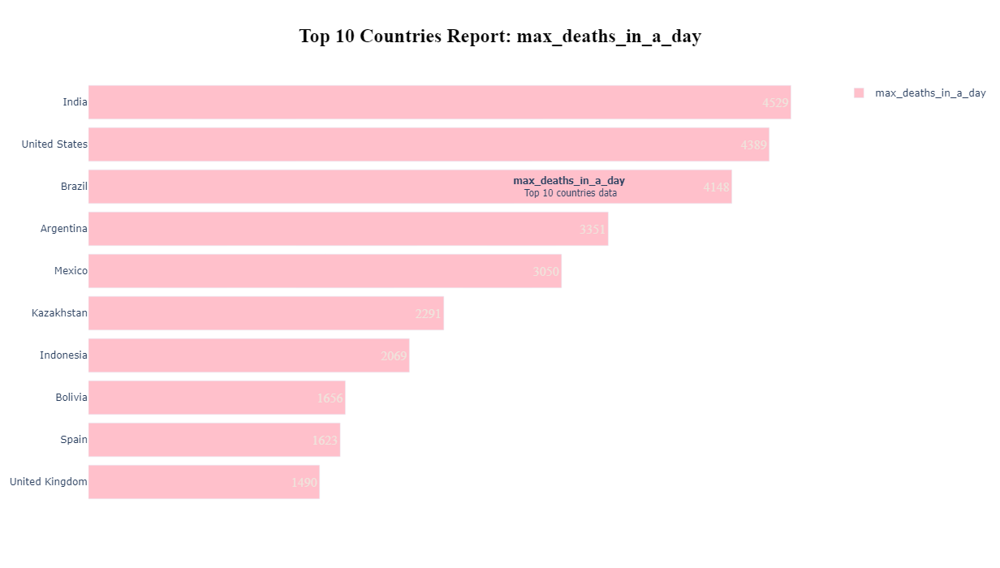

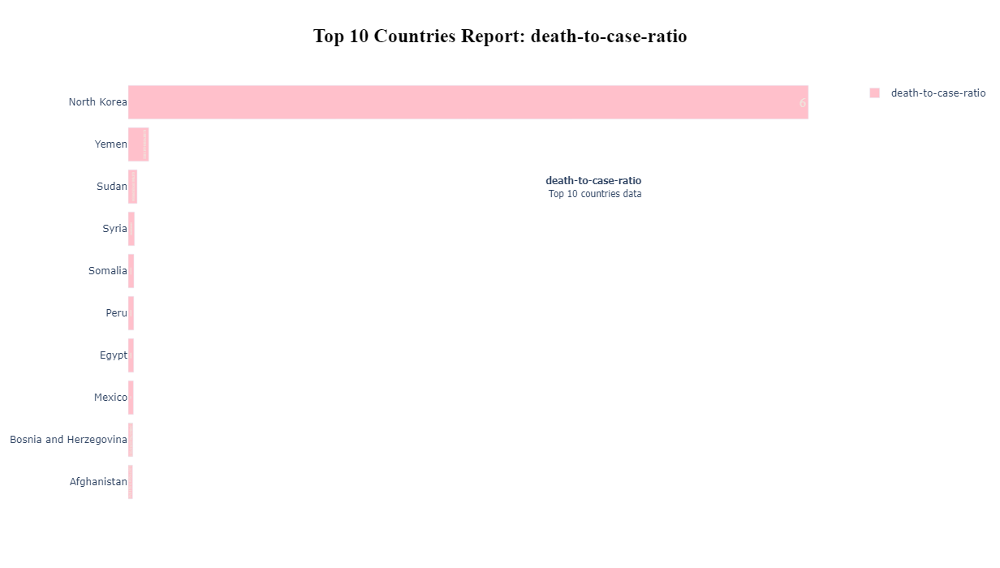

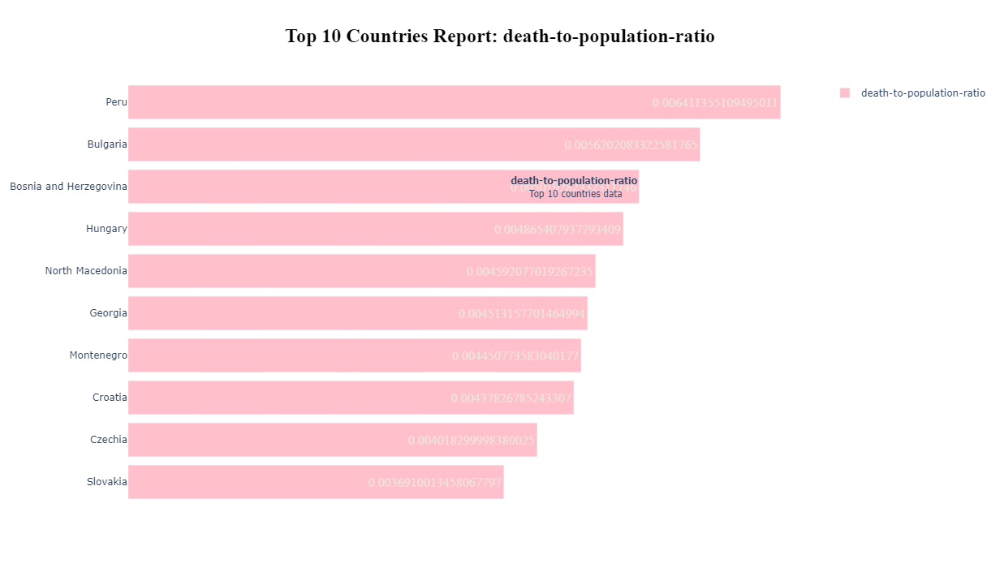

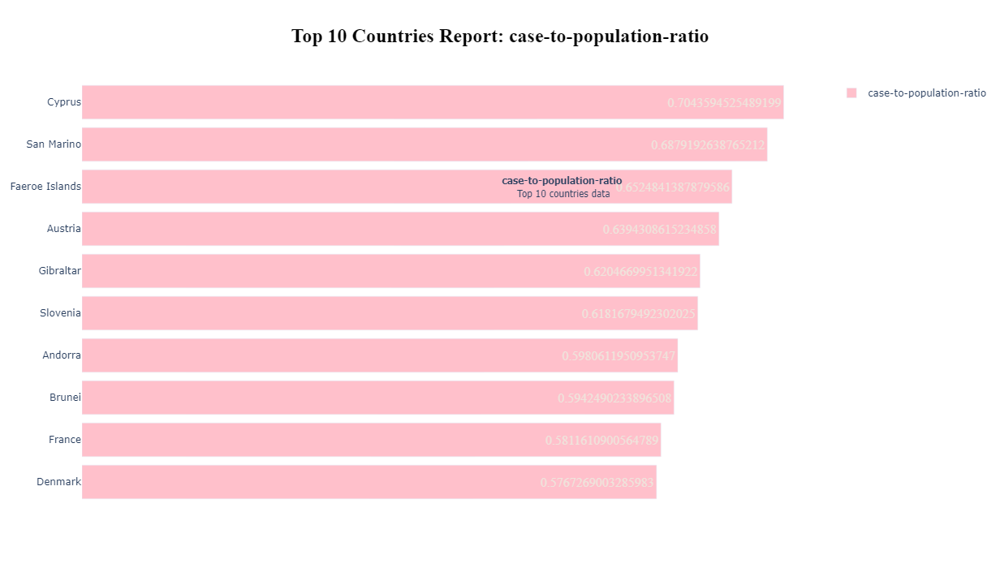

In [57]:
top_10_countries_report(df_country_map,'total_cases')
top_10_countries_report(df_country_map,'total_deaths')
top_10_countries_report(df_country_map,'max_cases_in_a_day')
top_10_countries_report(df_country_map,'max_deaths_in_a_day')
top_10_countries_report(df_country_map,'death-to-case-ratio')
top_10_countries_report(df_country_map,'death-to-population-ratio')
top_10_countries_report(df_country_map,'case-to-population-ratio')

#### Detail Analysis
US tops in total cases,deaths. It also tops highest cases in a single day<br>
 India top highest death in a single day<br>
 Whears in Avg Ratio of Death-case we have North Korea( Data seems false in here)<br>
 For other Avg Ratio of Death-Population and Cases-population we have Peru and Cyprus as leader. For Cyprus 70 percent population got affected and In Peru 0.6 percent polulation lost their lives due to Pandemic

### Country Wise Report
###### India,US,China,England,Brazil,United Kingdom and Pakistan are going to be calculated for further Analysis

In [58]:
def country_report(country):
    '''
    This function help us to analyze the full country report w.r.t to years for particular country
    '''
    df_iso=data[data['location']==country]

    fig = make_subplots(
        rows=4, cols=2,
        specs=[[{"type": "scatter"}, {"type": "scatter"}],

               [{"type": "scatter"}, {"type": "scatter"}],
              [{"type": "scatter"}, {"type": "scatter"}],
               [{"type": "scatter","colspan":2},None]
              ],
        # we can make it attractive by using simple html properties
        subplot_titles=("<span style='font-size:12px; font-family:Times New Roman'><b>Total Cases</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>Total Deaths</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>New Cases</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>New Deaths</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>Total Vaccinations</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>People Vaccinated</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>Fully Vaccinated_People</b></span>"
                        ),vertical_spacing = 0.05
    )

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["total_cases"],
                             ),1,1)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["total_deaths"],
                             ),1,2)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["new_cases"],
                             ),2,1)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["new_deaths"],
                             ),2,2)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["new_cases"],
                             ),2,1)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["new_deaths"],
                             ),2,2)
    fig.add_trace(go.Bar(x=df_iso["date"],
                             y=df_iso["total_vaccinations"],
                             ),3,1)

    fig.add_trace(go.Bar(x=df_iso["date"],
                             y=df_iso["people_vaccinated"],
                             ),3,2)
    
    fig.add_trace(go.Bar(x=df_iso["date"],
                         y=df_iso["people_fully_vaccinated"],
                         ),4,1)

    fig.update_layout(width=1000, height=2000,showlegend=False)

    fig.update_layout(plot_bgcolor="white", title=dict(
        text='<b>' + f'{"Covid Report for : "+country+" in "}' + '</b>',
        x=0.5,
        y=1,
        font=dict(
            family='moonspace',
            size=24,
            color='white'
        )))
    fig.update_layout(
    title='<b>'+country+'</b>')


    fig.show()

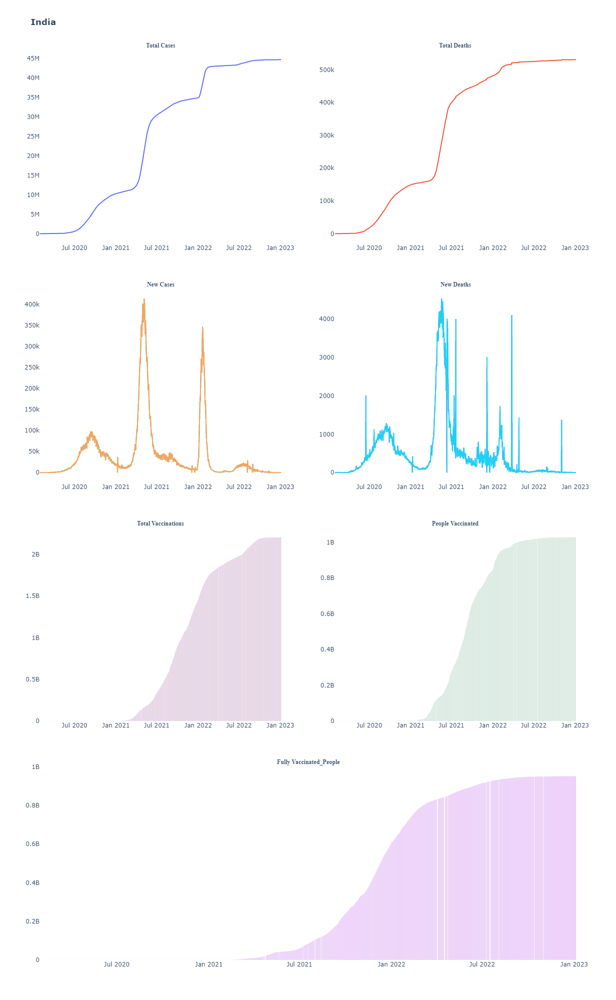

In [59]:
country_report('India')

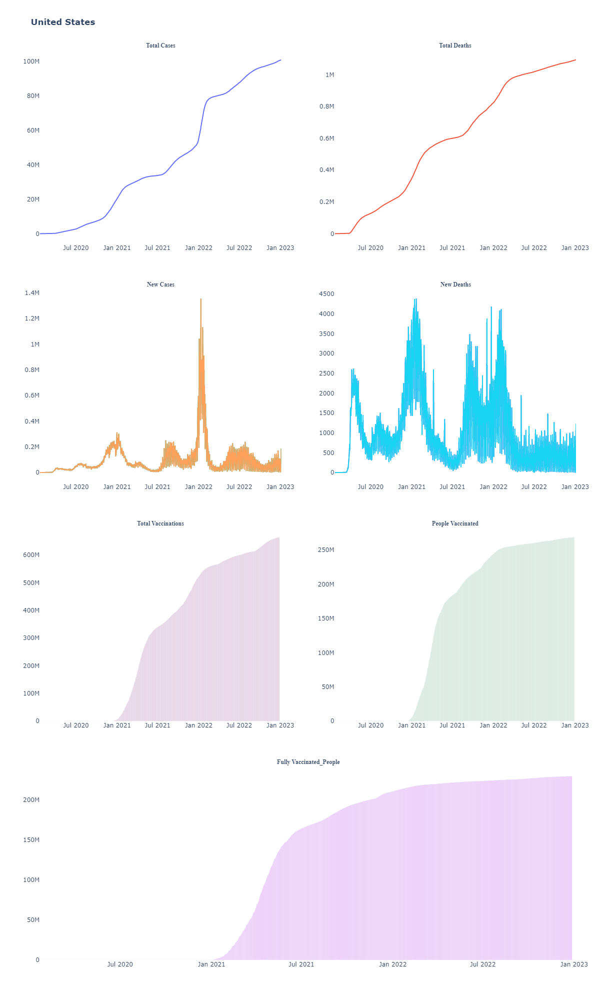

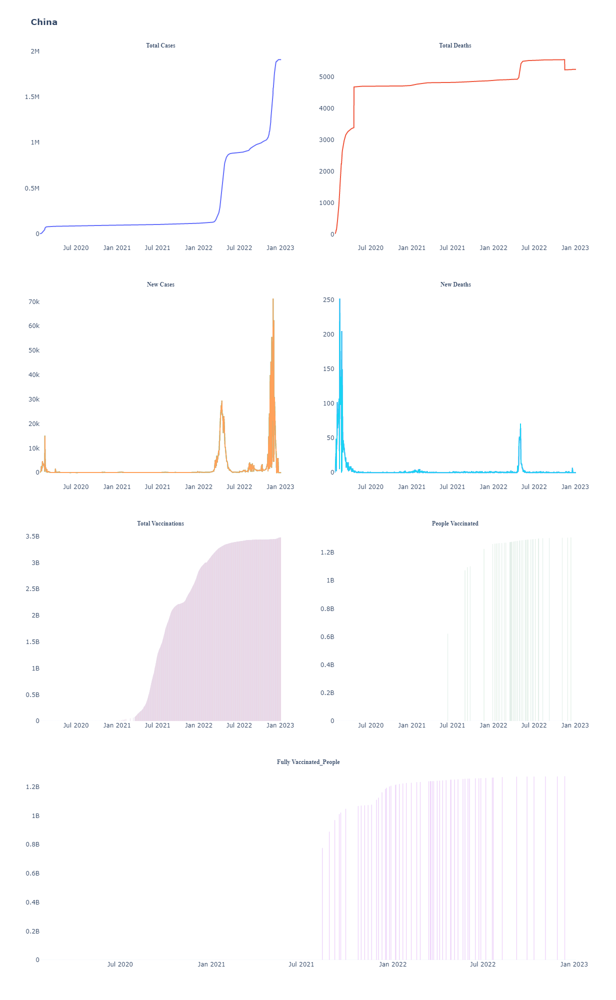

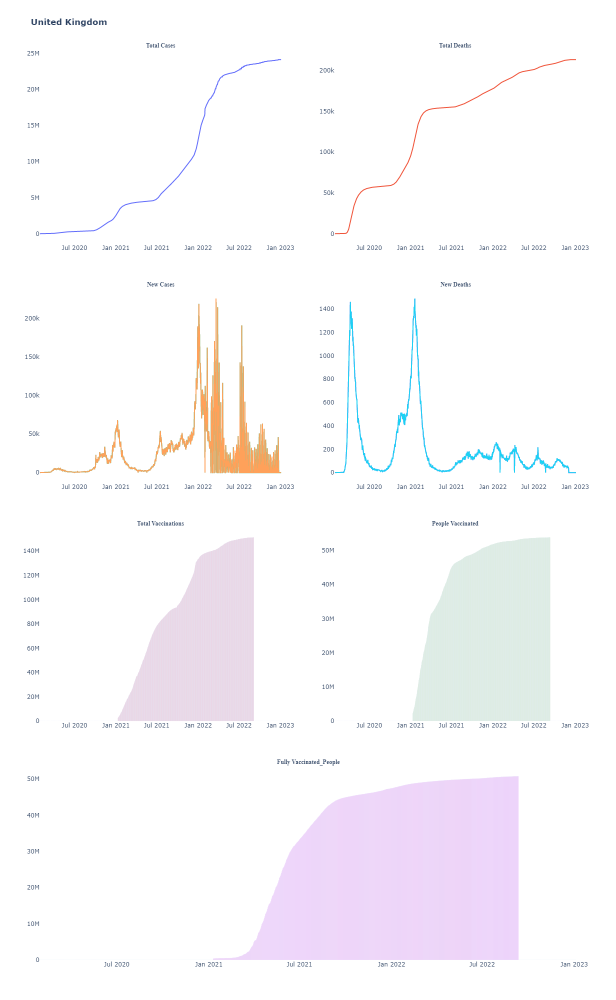

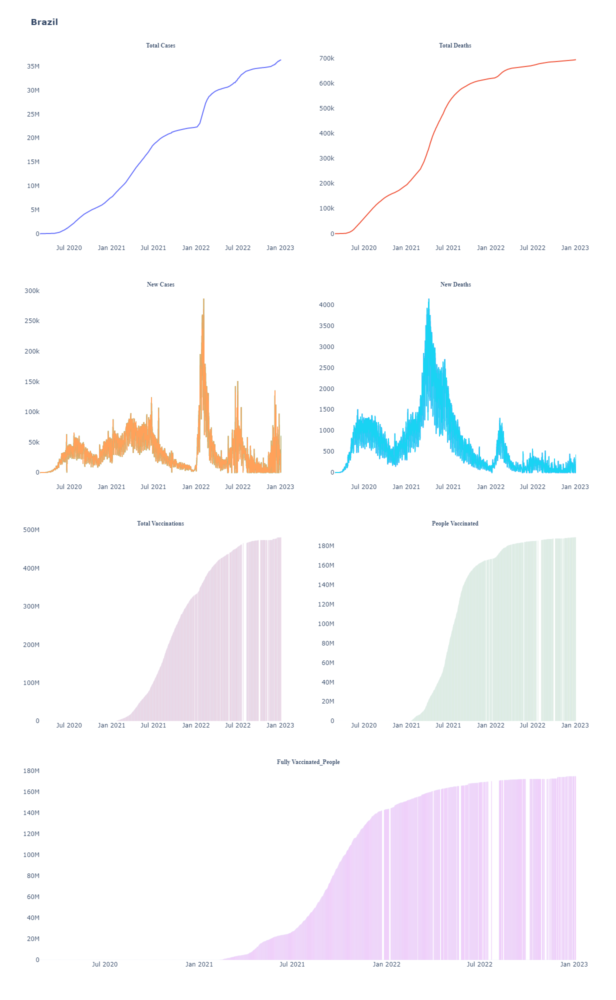

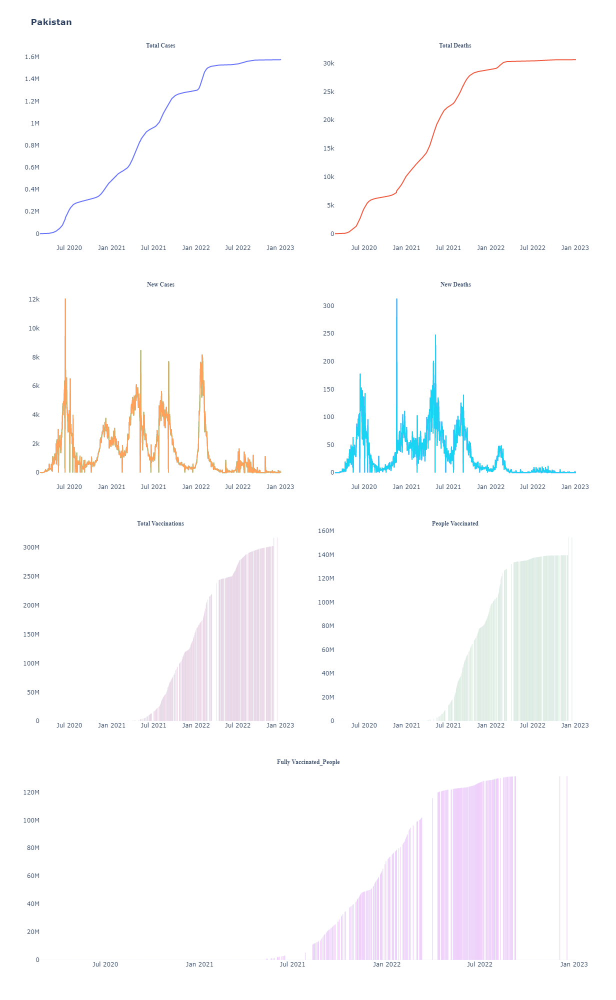

In [60]:
country_report('United States')
country_report('China')
country_report('United Kingdom')
country_report('Brazil')
country_report('Pakistan')

### Vacination Status

In [62]:
vaccination={}
for iso in data['location'].unique():
    vaccination[iso]={}
    vaccination[iso]['people_vaccinated']=data[data['location']==iso]['people_vaccinated'].sum()
    vaccination[iso]['people_fully_vaccinated']=data[data['location']==iso]['people_fully_vaccinated'].sum()
    vaccination[iso]['total_boosters']=data[data['location']==iso]['total_boosters'].sum()
    
vacc_df=pd.DataFrame(vaccination).T



def vaccination_report(country):
    '''
    This function provide the vaccination details of the country
    '''
    fig = make_subplots(
            rows=1, cols=2,
            specs=[[{"type": "domain"}, {"type": "xy"}],

                   ],
            # we can make it attractive by using simple html properties
            subplot_titles=("<span style='font-size:12px; font-family:Times New Roman'><b>"+'Vaccination Status'+"</b></span>",
                            "<span style='font-size:12px; font-family:Times New Roman'><b>Vaccination_Ratio</b></span>",
                            )
        )

    class_name_list = list(vaccination[country].keys())
    percentage_of_class_name_list = list(vaccination[country].values())
    # Pizza-Chart

    colors = ['#004c70', '#F1948A','#2e3d44']
    # colors = ['#004c70','#4d7259', '#2e3d44','#70909f','#990000']
    labels = class_name_list
    value = percentage_of_class_name_list
    fig.add_trace(go.Pie(labels=labels,values=value),
                  row=1, col=1)
    fig.update_traces(textposition='inside', hoverinfo='percent+label', 
                      textinfo='label+percent',
                      marker=dict(colors=colors,
                    line=dict(color='#000000', width=2)))

    fig.add_trace(go.Bar(x=data[data['location']==country]["date"],
                             y=data[data['location']==country]["vaccination_ratio"],
                        ),1,2)
    fig.update_layout(width=900, height=450,showlegend=False)

    fig.update_layout(plot_bgcolor="black", title=dict(
        text='<b>' + f'{"Vaccination  Report for : "+country}' + '</b>',
        x=0.5,
        y=1,
        font=dict(
            family='moonspace',
            size=24,
            color='white'
        )))
    fig.update_layout(
    title='<b>'+country+'</b>')
    fig.show()

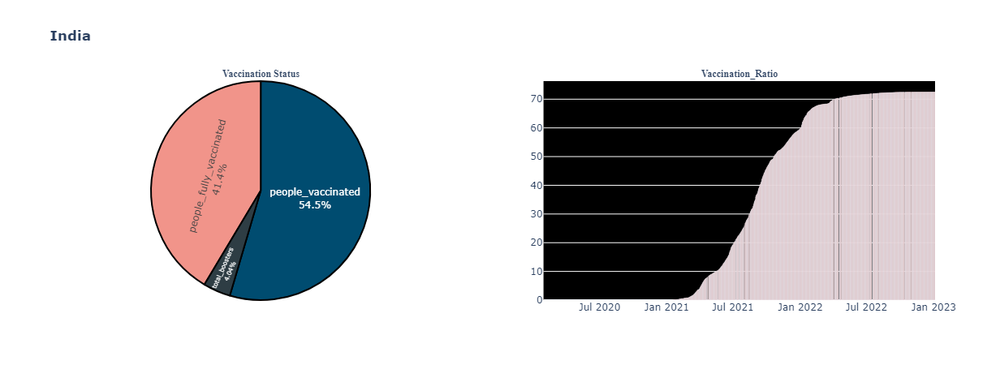

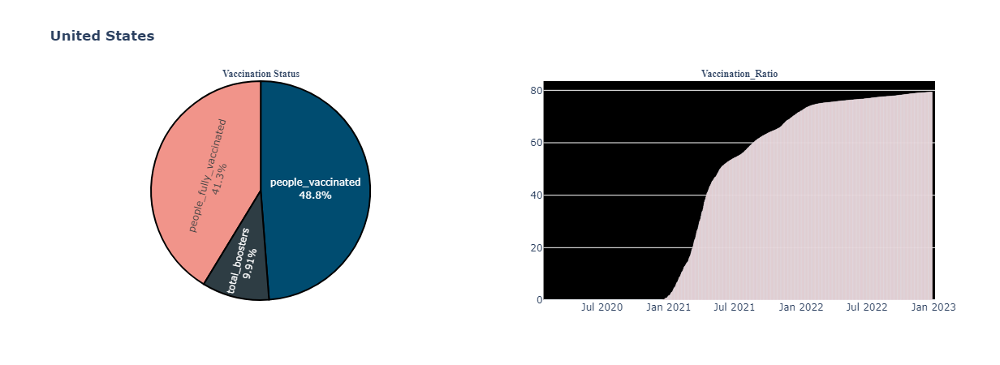

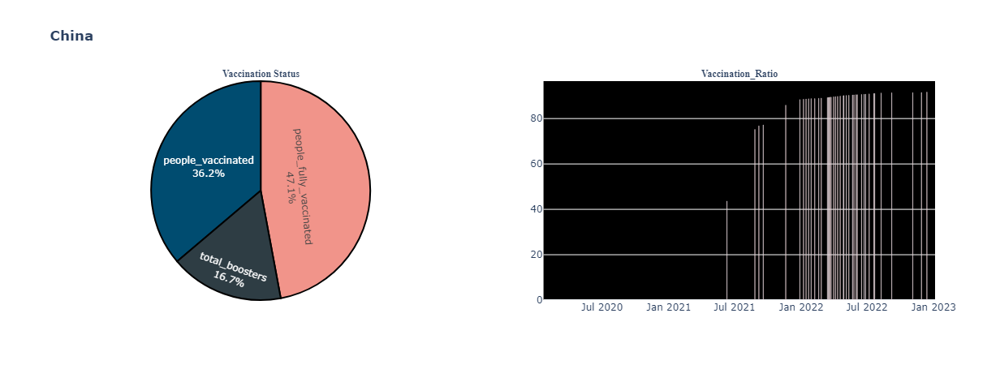

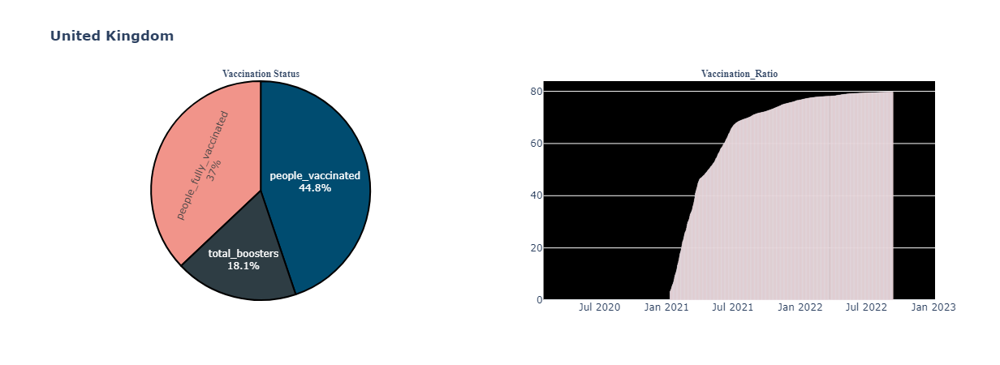

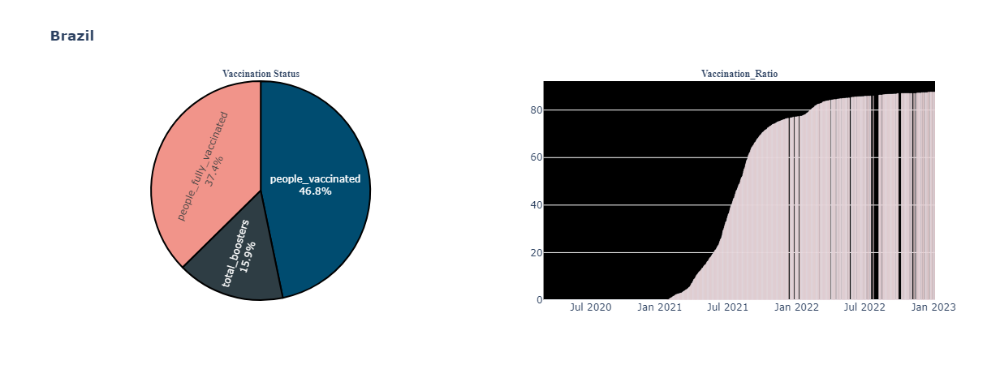

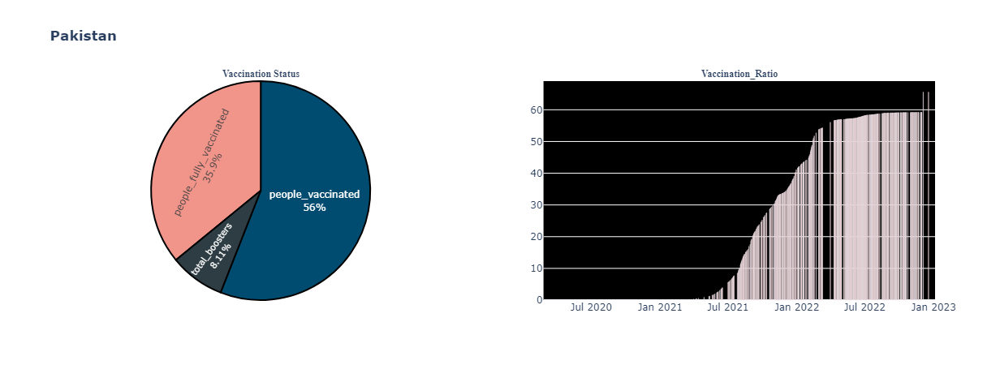

In [63]:
#India,US,China,Brazil,United Kingdom and Pakistan are used for further analysis
vaccination_report('India')
vaccination_report('United States')
vaccination_report('China')
vaccination_report('United Kingdom')
vaccination_report('Brazil')
vaccination_report('Pakistan')

#### Detailed Analysis
In terms of Vaccination all coun try has more then 40 percent of people vaccinated
The Fully vaccinated people lie in range of 35-42 percent. Inwhich India has Highest. As per this data very few people has taken booster dose


### Compare country with India

In [83]:
def compare_country(country,country2):
    '''It compared the features of one country with another 
    '''
    fig = make_subplots(
        rows=2, cols=2,
        specs=[[{"type": "scatter"}, {"type": "scatter"}],
               [{"type": "scatter"}, {"type": "scatter"}],
               ],
        # we can make it attractive by using simple html properties
        subplot_titles=("<span style='font-size:12px; font-family:Times New Roman'><b> New Cases "+country+"</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b> New Cases "+country2+"</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>New Deaths "+country+"</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>New Deaths "+country2+"</b></span>"
                        )
    )
    fig.add_trace(go.Scatter(x=data[data['location']==country]["date"],
                             y=data[data['location']==country]["new_cases"],
                            showlegend=False),1,1)
    fig.add_trace(go.Scatter(x=data[data['location']==country2]["date"],
                             y=data[data['location']==country2]["new_cases"],
                            showlegend=False),1,2)
    fig.add_trace(go.Scatter(x=data[data['location']==country]["date"],
                             y=data[data['location']==country]["new_deaths"],
                            showlegend=False),2,1)
    fig.add_trace(go.Scatter(x=data[data['location']==country2]["date"],
                             y=data[data['location']==country2]["new_deaths"],
                            showlegend=False),2,2)
    fig.update_layout(width=900, height=650,showlegend=False)

    fig.update_layout(plot_bgcolor="white", title=dict(
            text='<b>' + f'{"Covid Cases Analysis  "+country+" vs" +country2}' + '</b>',
            x=0.5,
            y=0.95,
            font=dict(
                family='moonspace',
                size=20,
                color='white'
            )))

    fig.update_layout(
    title='<b>'+country+' vs '+country2+'</b>')
    fig.show()

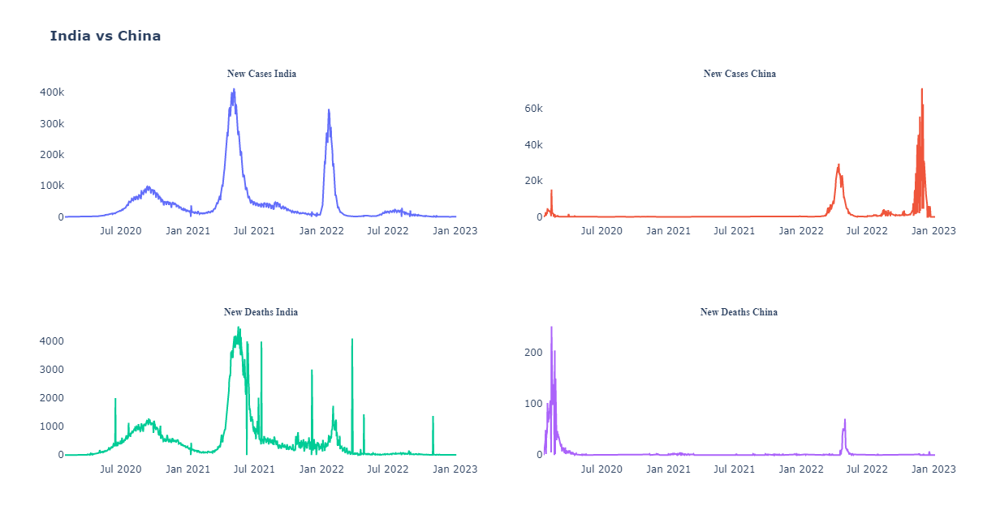

In [84]:
compare_country('India','China')

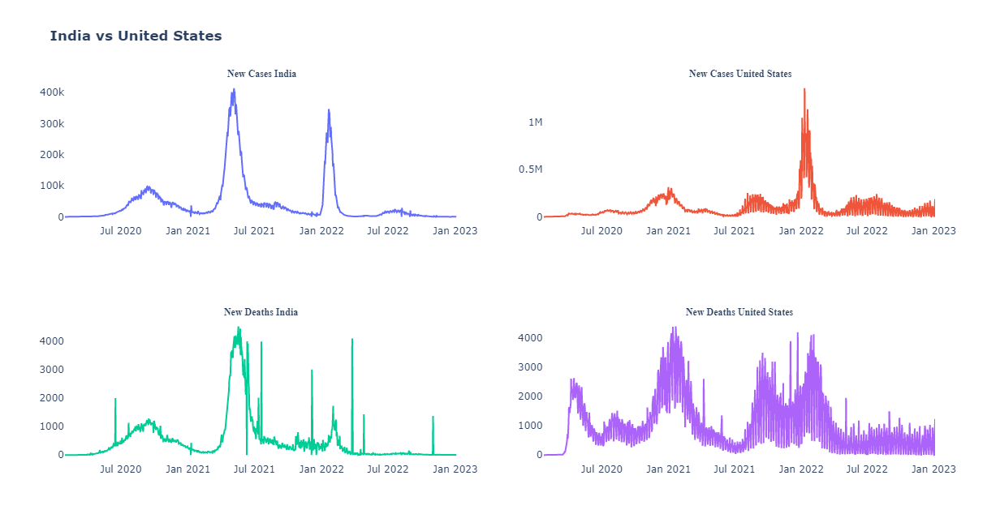

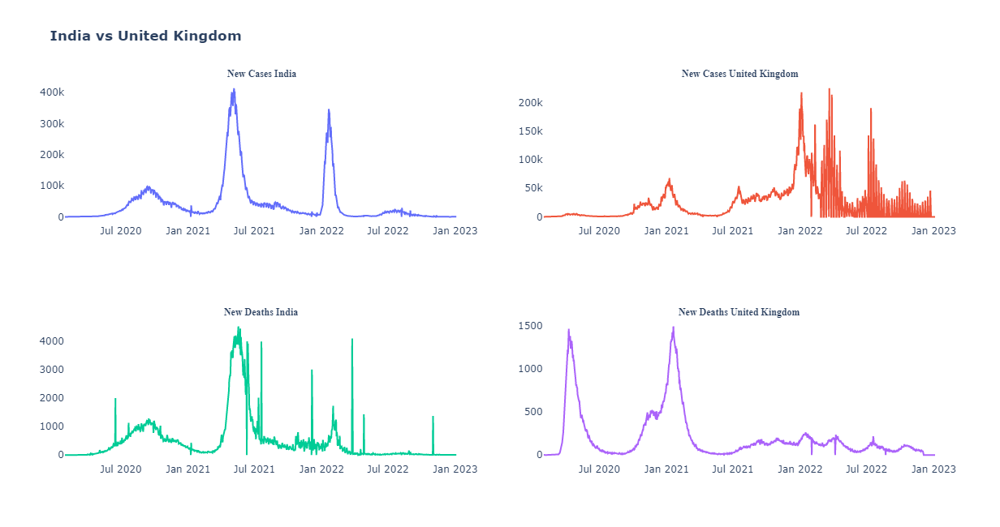

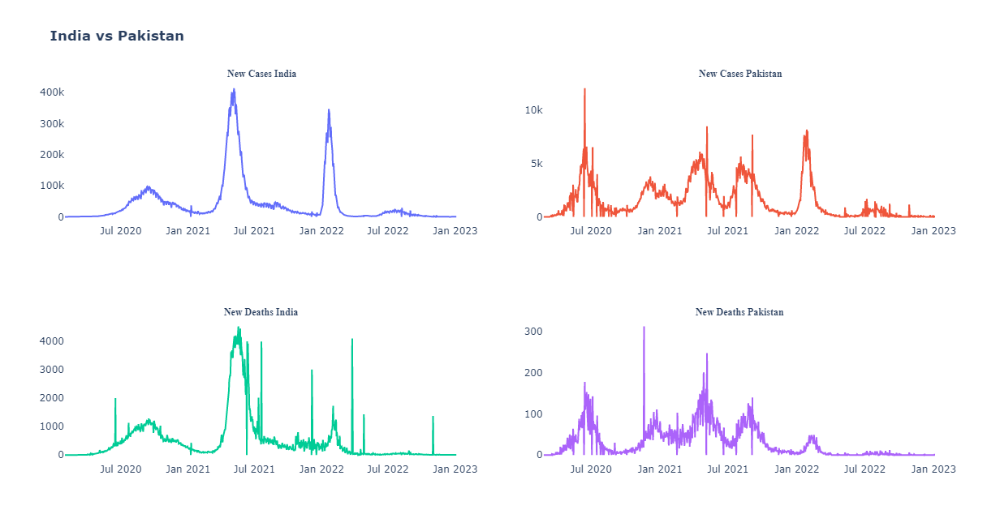

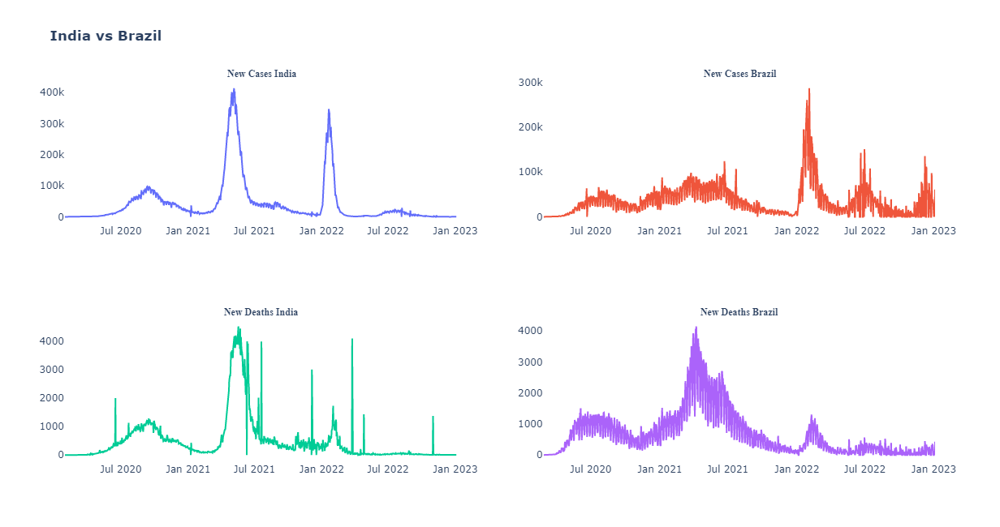

In [85]:
compare_country('India','United States')
compare_country('India','United Kingdom')
compare_country('India','Pakistan')
compare_country('India','Brazil')

#### Detailed Analysis
Above graph shows Indias comparison with other countries

In [86]:
def comparison_country(cal):
    fig=go.Figure()
    for col in ['India','China','United States','Brazil','Pakistan','United Kingdom']:
        fig.add_trace(go.Scatter(x=data[data['location']==col]["date"],
                                 y=data[data['location']==col][cal],
                                 name=col,showlegend=True))
    
    fig.update_layout(plot_bgcolor="white", title=dict(
        text='<b>' + cal + '</b>',
        x=0.5,
        y=1,
        font=dict(
            family='moonspace',
            size=24,
            color='black'
        )))
    fig.update_layout(
        title='<b>'+cal+'</b>')
    fig.show()

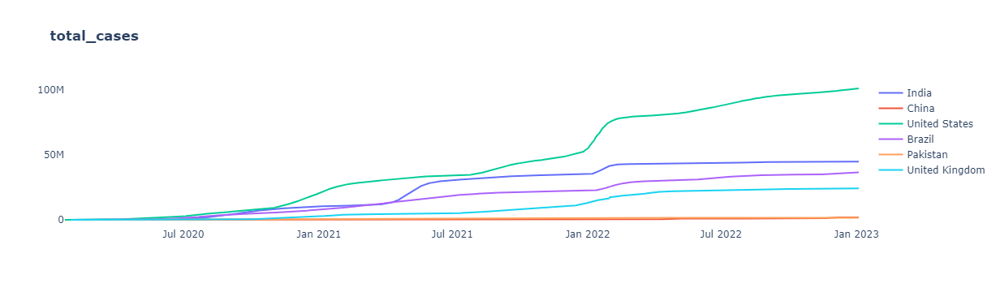

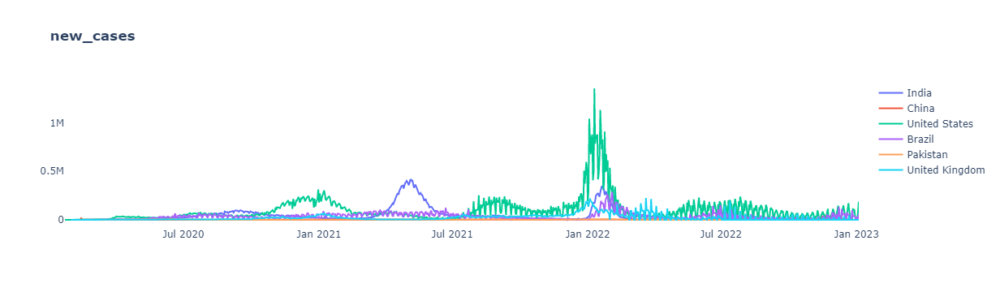

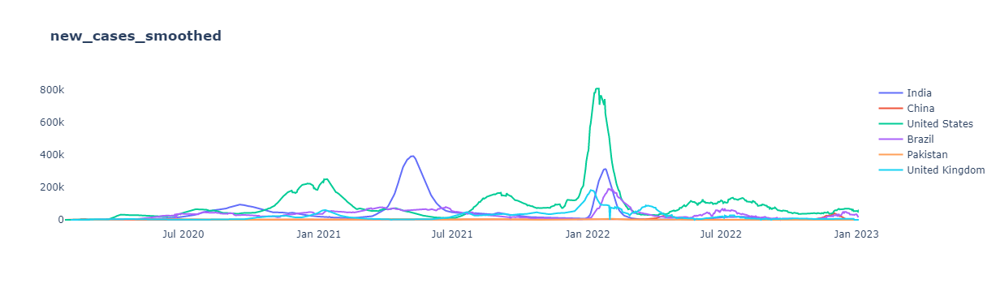

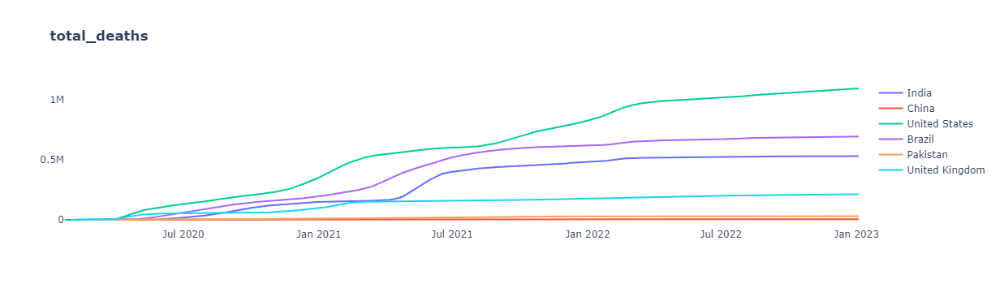

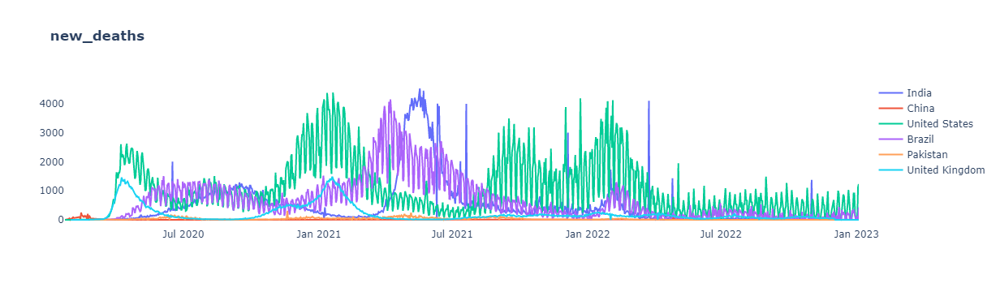

...

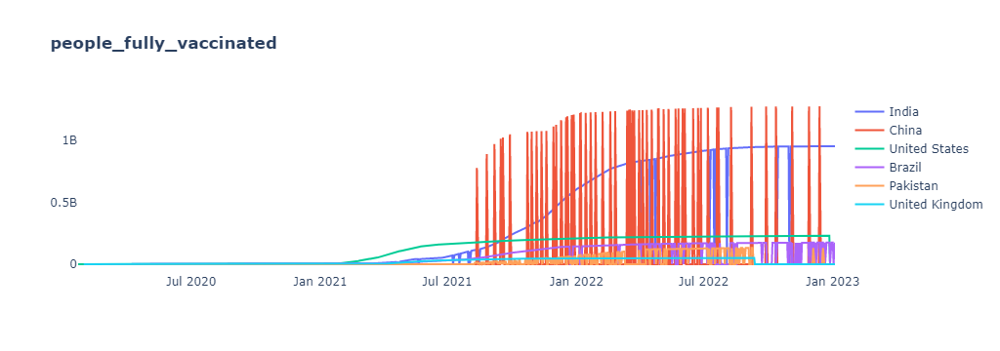

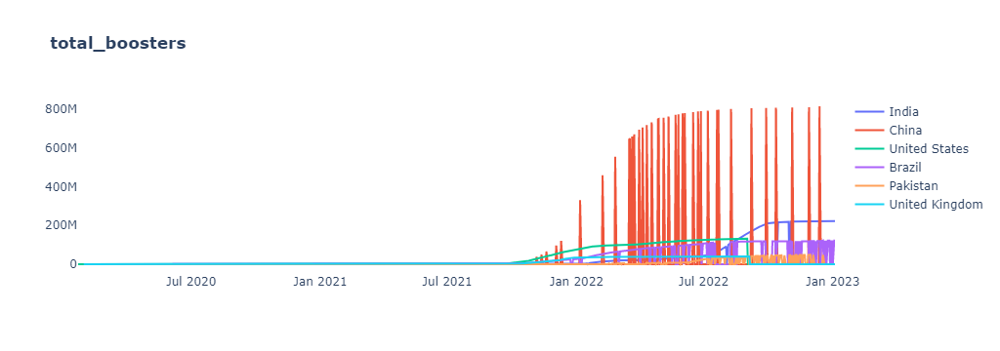

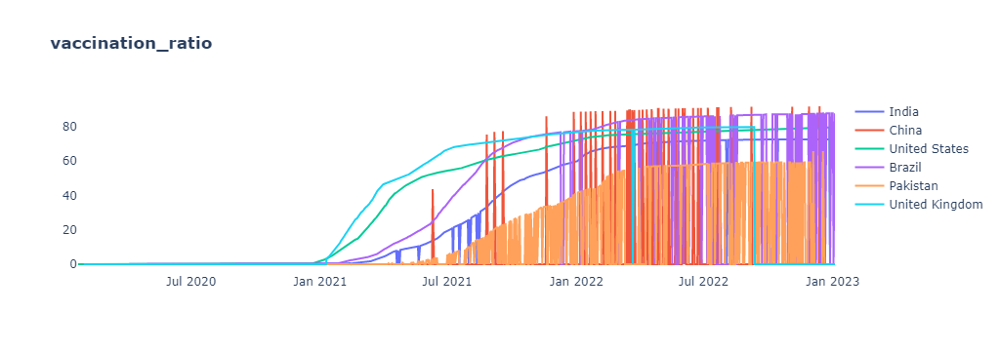

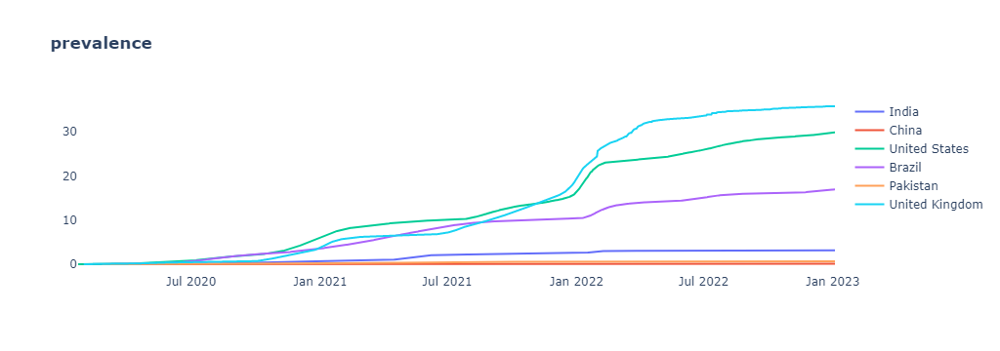

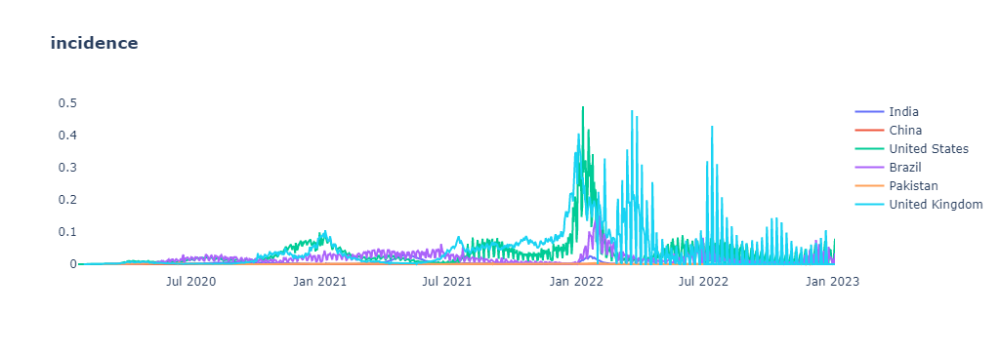

In [87]:
columns = ['total_cases', 'new_cases', 'new_cases_smoothed','total_deaths', 'new_deaths', 'new_deaths_smoothed','reproduction_rate', 'total_vaccinations', 'people_vaccinated','people_fully_vaccinated', 'total_boosters','vaccination_ratio', 'prevalence', 'incidence']
for column in columns:
    comparison_country(column)

In [70]:
!pip install pycountry_convert

  Using cached pycountry_convert-0.7.2-py3-none-any.whl (13 kB)
  Using cached pprintpp-0.4.0-py2.py3-none-any.whl (16 kB)
  Using cached pycountry-22.3.5-py2.py3-none-any.whl
  Using cached repoze.lru-0.7-py3-none-any.whl (10 kB)
  Using cached pytest_mock-3.10.0-py3-none-any.whl (9.3 kB)


### Continent wise Analysis

In [71]:
import pycountry_convert as pc

def country_to_continent(country_name):
    try:
        country_alpha2 = pc.country_name_to_country_alpha2(country_name)
        country_continent_code = pc.country_alpha2_to_continent_code(country_alpha2)
        country_continent_name = pc.convert_continent_code_to_continent_name(country_continent_code)
        return country_continent_name
    except:
        return "South America"

# Example
data['Continent'] = data['location'].apply(country_to_continent)

In [72]:
data.head()

,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,reproduction_rate,total_vaccinations,...,total_boosters,population,vaccination_ratio,prevalence,incidence,year,year-month,month,day,Continent
0,Afghanistan,2020-02-24,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41128772.0,0.0,0.000012,0.000012,2020,2020-Feb,Feb,24,Asia
1,Afghanistan,2020-02-25,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41128772.0,0.0,0.000012,0.000000,2020,2020-Feb,Feb,25,Asia
2,Afghanistan,2020-02-26,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41128772.0,0.0,0.000012,0.000000,2020,2020-Feb,Feb,26,Asia
3,Afghanistan,2020-02-27,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41128772.0,0.0,0.000012,0.000000,2020,2020-Feb,Feb,27,Asia
4,Afghanistan,2020-02-28,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41128772.0,0.0,0.000012,0.000000,2020,2020-Feb,Feb,28,Asia


In [73]:
data.columns

Index(['location', 'date', 'total_cases', 'new_cases', 'new_cases_smoothed',
       'total_deaths', 'new_deaths', 'new_deaths_smoothed',
       'reproduction_rate', 'total_vaccinations', 'people_vaccinated',
       'people_fully_vaccinated', 'total_boosters', 'population',
       'vaccination_ratio', 'prevalence', 'incidence', 'year', 'year-month',
       'month', 'day', 'Continent'],
      dtype='object')

In [74]:
vals = ['location','total_cases', 'new_cases', 'new_cases_smoothed','total_deaths', 'new_deaths', 'new_deaths_smoothed','total_vaccinations', 'people_vaccinated','people_fully_vaccinated', 'total_boosters']
continent = pd.pivot_table(data, values =vals, index =['Continent','date'],aggfunc = np.sum).reset_index().fillna(method='ffill', axis=1)
  

In [75]:
continent.head()

,Continent,date,new_cases,new_cases_smoothed,new_deaths,new_deaths_smoothed,people_fully_vaccinated,people_vaccinated,total_boosters,total_cases,total_deaths,total_vaccinations
0,Africa,2020-02-07,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Africa,2020-02-08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Africa,2020-02-09,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Africa,2020-02-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Africa,2020-02-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [77]:
continent['year']=pd.to_datetime(continent['date']).dt.strftime('%Y')
continent['year-month']=pd.to_datetime(continent['date']).dt.strftime('%Y-%b')
continent['month']=pd.to_datetime(continent['date']).dt.strftime('%b')
continent['day']=pd.to_datetime(continent['date']).dt.strftime('%d')

In [78]:
def comparison_continent(cal):
    fig=go.Figure()
    for col in ['Asia','North America','South America','Europe','Oceania','Africa']:
        fig.add_trace(go.Scatter(x=continent[continent['Continent']==col]["date"],
                                 y=continent[continent['Continent']==col][cal],
                                 name=col,showlegend=True))
    
    fig.update_layout(plot_bgcolor="white", title=dict(
        text='<b>' + cal + '</b>',
        x=0.5,
        y=1,
        font=dict(
            family='moonspace',
            size=24,
            color='black'
        )))
    fig.update_layout(
        title='<b>'+cal+'</b>')
    fig.show()

In [79]:
continent.columns

Index(['Continent', 'date', 'new_cases', 'new_cases_smoothed', 'new_deaths',
       'new_deaths_smoothed', 'people_fully_vaccinated', 'people_vaccinated',
       'total_boosters', 'total_cases', 'total_deaths', 'total_vaccinations',
       'year', 'year-month', 'month', 'day'],
      dtype='object')

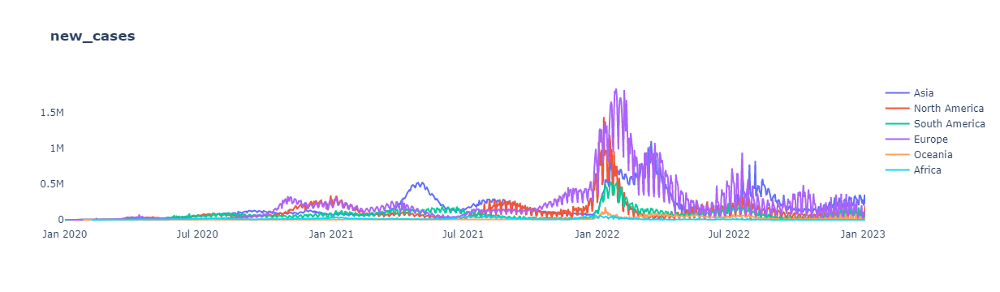

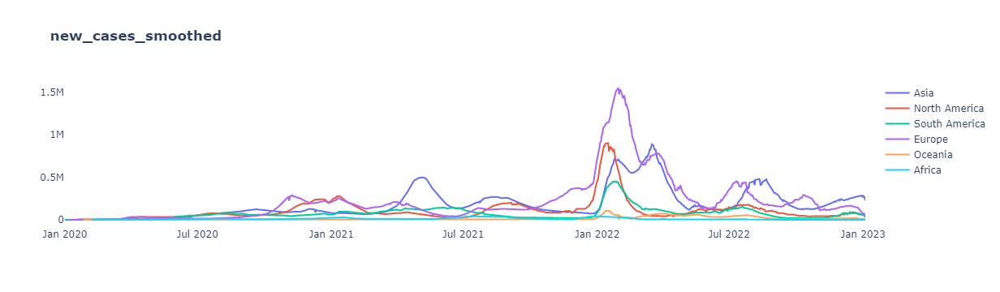

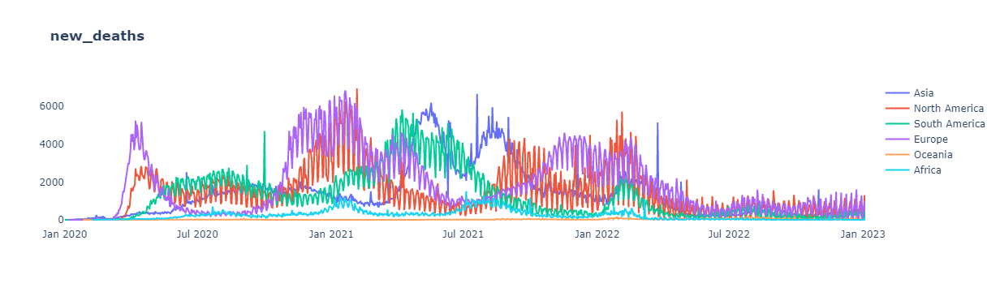

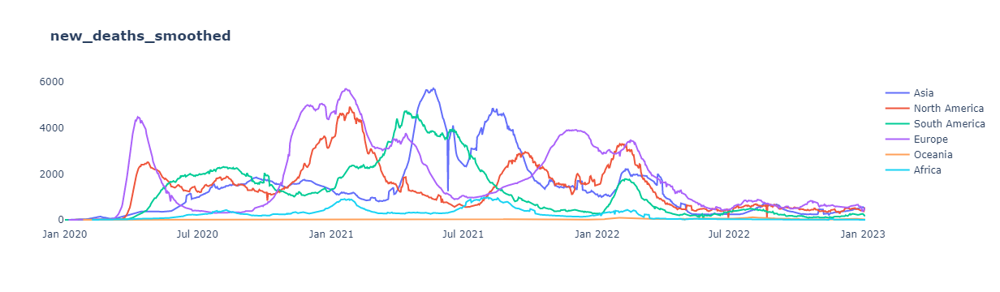

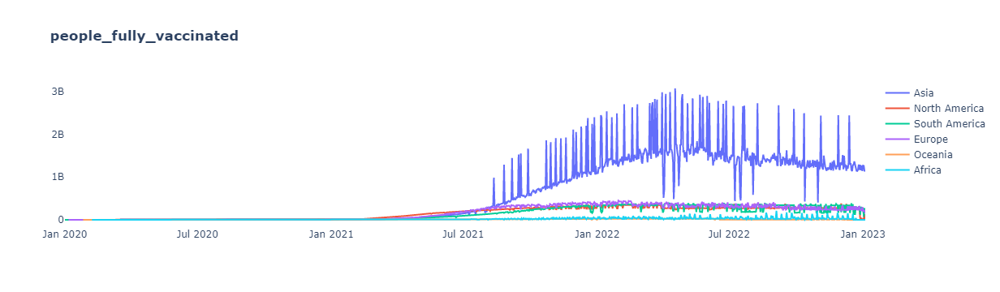

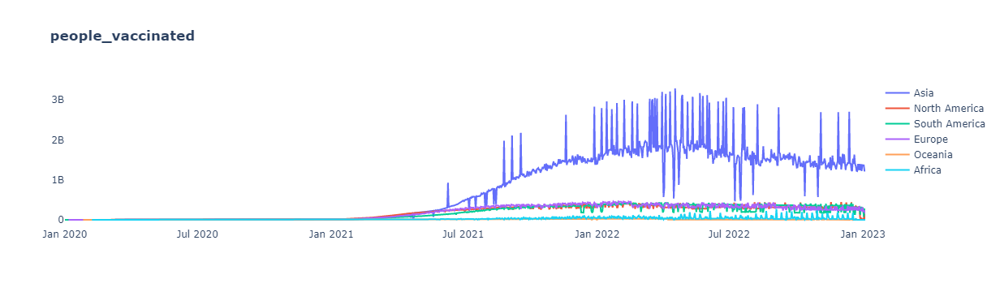

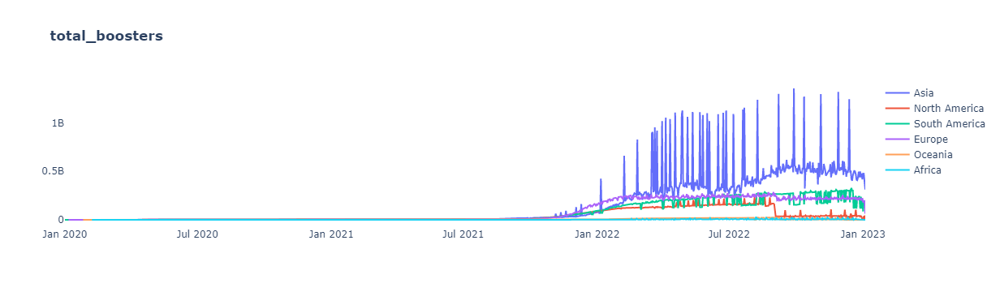

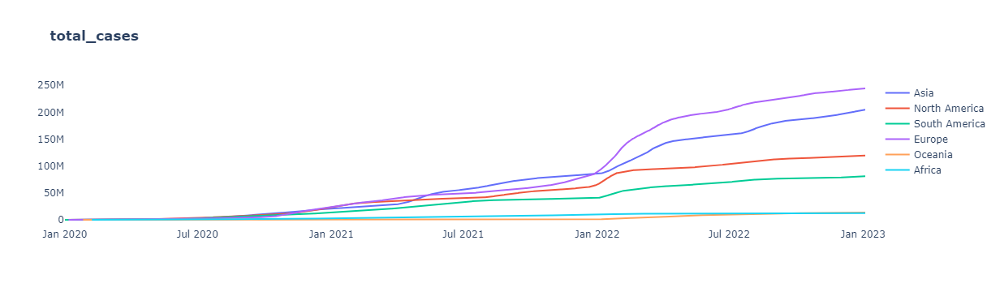

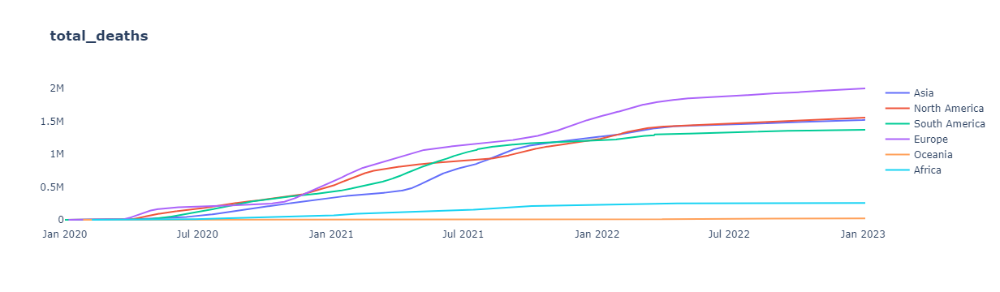

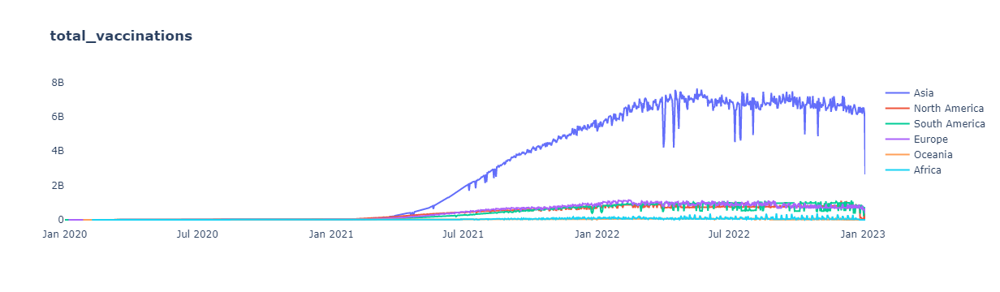

In [80]:
columns = ['new_cases', 'new_cases_smoothed', 'new_deaths','new_deaths_smoothed', 'people_fully_vaccinated', 'people_vaccinated','total_boosters', 'total_cases', 'total_deaths', 'total_vaccinations']
for column in columns:
    comparison_continent(column)

In [81]:
def continent_report(conti):
    '''
    This function help us to analyze the full continent report w.r.t to years for particular continent
    '''
    df_iso=continent[continent['Continent']==conti]

    fig = make_subplots(
        rows=4, cols=2,
        specs=[[{"type": "scatter"}, {"type": "scatter"}],

               [{"type": "scatter"}, {"type": "scatter"}],
              [{"type": "scatter"}, {"type": "scatter"}],
               [{"type": "scatter","colspan":2},None]
              ],
        # we can make it attractive by using simple html properties
        subplot_titles=("<span style='font-size:12px; font-family:Times New Roman'><b>Total Cases</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>Total Deaths</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>New Cases</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>New Deaths</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>Total Vaccinations</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>People Vaccinated</b></span>",
                        "<span style='font-size:12px; font-family:Times New Roman'><b>Fully Vaccinated_People</b></span>"
                        ),vertical_spacing = 0.05
    )

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["total_cases"],
                             ),1,1)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["total_deaths"],
                             ),1,2)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["new_cases"],
                             ),2,1)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["new_deaths"],
                             ),2,2)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["new_cases"],
                             ),2,1)

    fig.add_trace(go.Scatter(x=df_iso["date"],
                             y=df_iso["new_deaths"],
                             ),2,2)
    fig.add_trace(go.Bar(x=df_iso["date"],
                             y=df_iso["total_vaccinations"],
                             ),3,1)

    fig.add_trace(go.Bar(x=df_iso["date"],
                             y=df_iso["people_vaccinated"],
                             ),3,2)
    
    fig.add_trace(go.Bar(x=df_iso["date"],
                         y=df_iso["people_fully_vaccinated"],
                         ),4,1)

    fig.update_layout(width=1000, height=2000,showlegend=False)

    fig.update_layout(plot_bgcolor="white", title=dict(
        text='<b>' + f'{"Covid Report for : "+conti+" in "}' + '</b>',
        x=0.5,
        y=1,
        font=dict(
            family='moonspace',
            size=24,
            color='white'
        )))
    fig.update_layout(
    title='<b>'+conti+'</b>')


    fig.show()
    

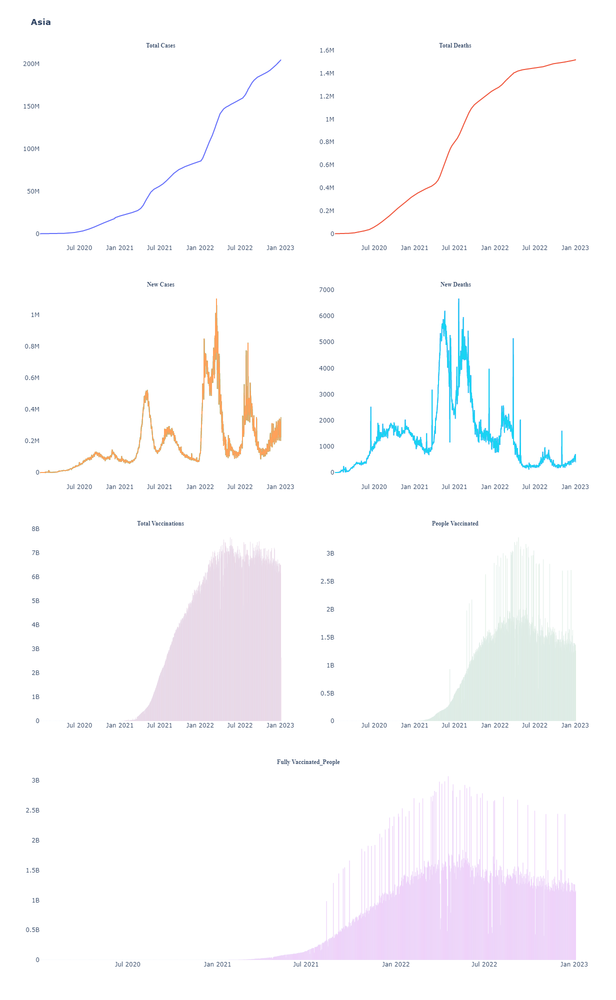

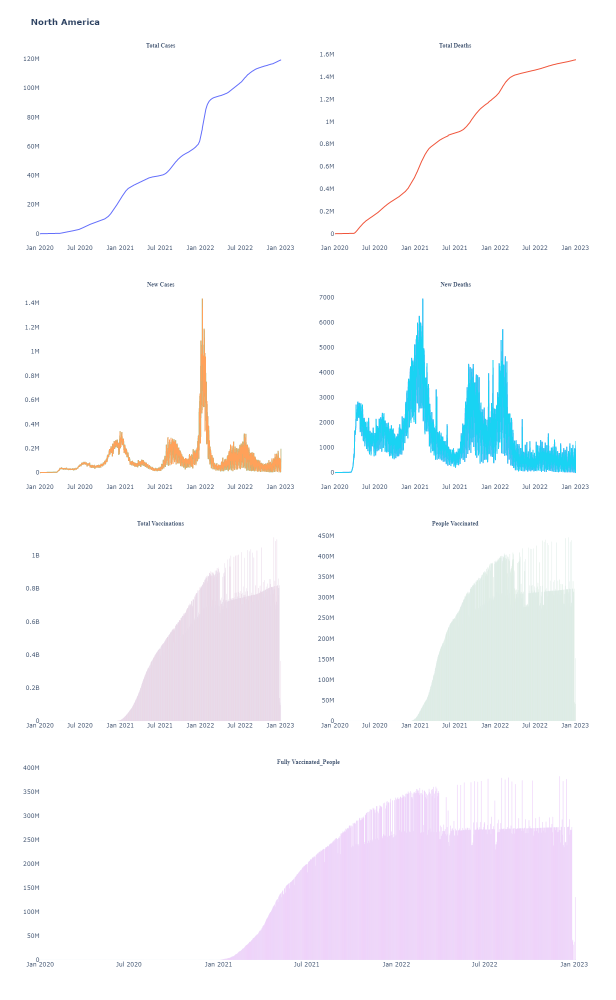

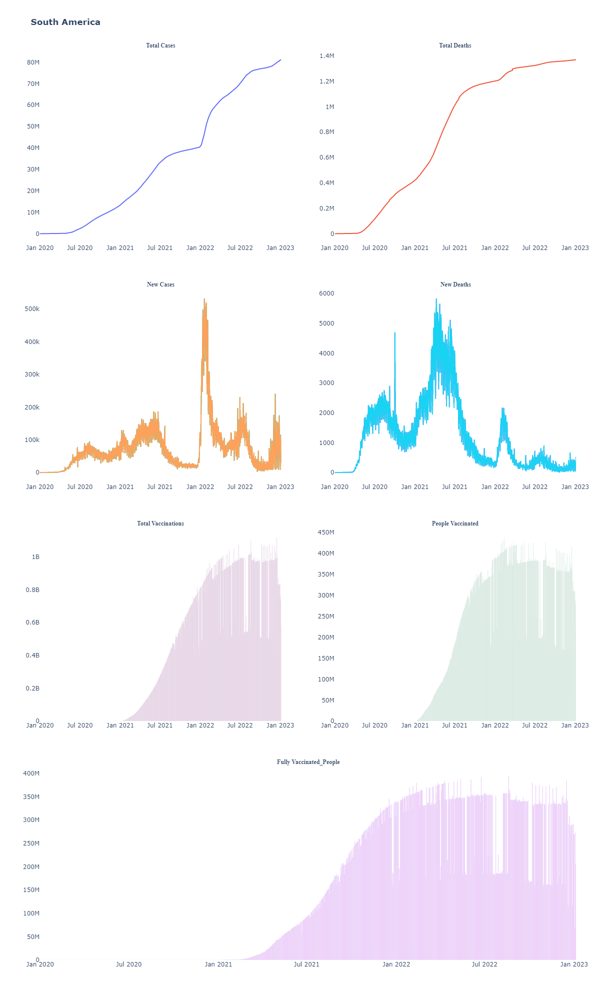

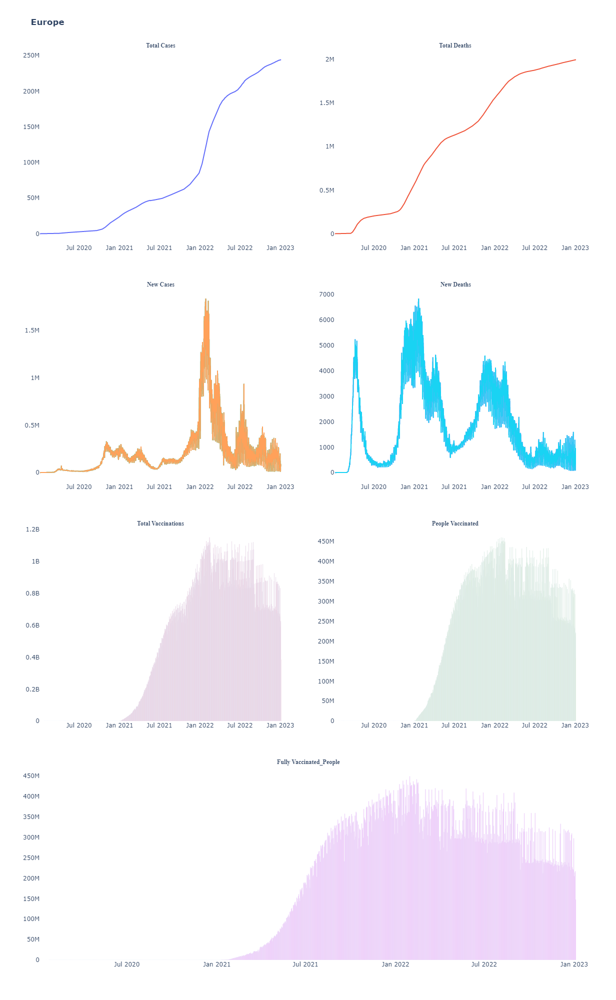

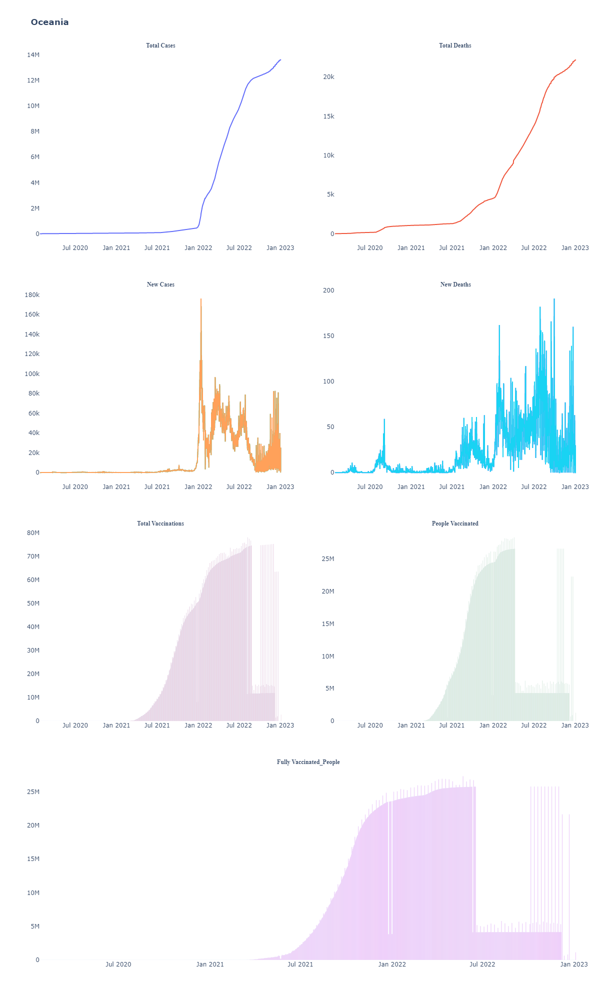

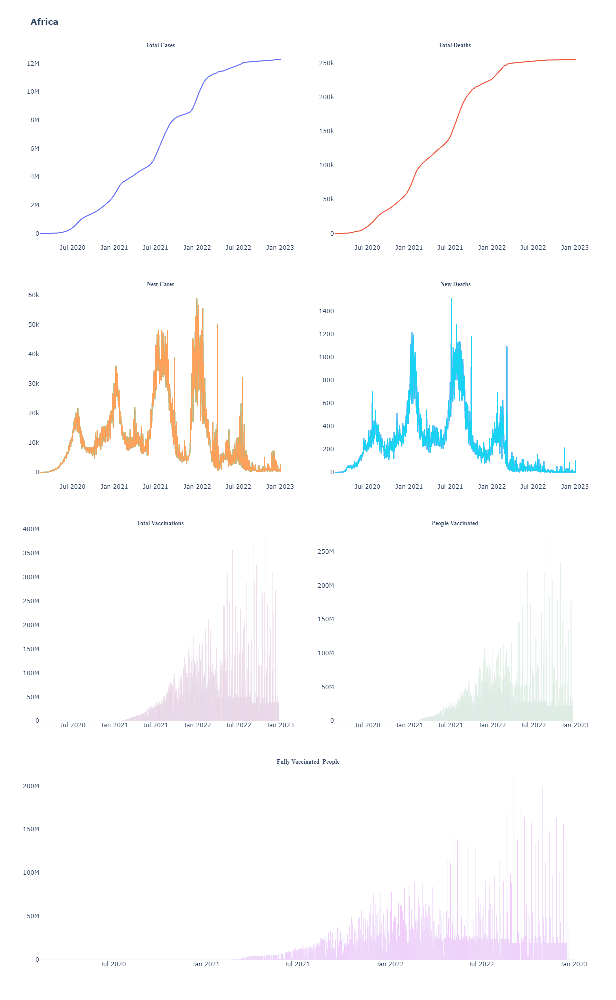

In [82]:
for col in ['Asia','North America','South America','Europe','Oceania','Africa']:
    continent_report(col)
    

#### Detail Analysis for continent:
Asia has highest number of total_deaths,total_cases
Europe has highest number of max_cases_in_a_day
North America has highesht death in a day